In [22]:
import os
import torch
import numpy as np
from tqdm import tqdm_notebook
import imageio
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
from skimage import img_as_ubyte

from PIL import Image

# io utils
from pytorch3d.io import load_obj

# datastructures
from pytorch3d.structures import Meshes, Textures

# 3D transformations functions
from pytorch3d.transforms import Rotate, Translate

# rendering components
from pytorch3d.renderer import (
    OpenGLPerspectiveCameras, look_at_view_transform, look_at_rotation, 
    RasterizationSettings, MeshRenderer, MeshRasterizer, BlendParams,
    SoftSilhouetteShader, HardPhongShader, TexturedSoftPhongShader, PointLights
)

In [2]:
DATA_DIR = os.path.join('data', 'meshes', 'sphere')
mesh_path = os.path.join(DATA_DIR, 'calota180.obj')

In [3]:
device = torch.device("cpu")
# torch.cuda.set_device(device)

# Load the obj and ignore the textures and materials.
verts, faces_idx, _ = load_obj(mesh_path)
faces = faces_idx.verts_idx

# Initialize each vertex to be white in color.
verts_rgb = torch.ones_like(verts)[None]  # (1, V, 3)
textures = Textures(verts_rgb=verts_rgb.to(device))

# Create a Meshes object for the teapot. Here we have only one mesh in the batch.
calota_mesh = Meshes(
    verts=[verts.to(device)],   
    faces=[faces.to(device)], 
    textures=textures
)

In [6]:
# Initialize an OpenGL perspective camera.
cameras = OpenGLPerspectiveCameras(device=device)

# We will also create a phong renderer. This is simpler and only needs to render one face per pixel.
raster_settings = RasterizationSettings(
    image_size=256, 
    blur_radius=0.0, 
    faces_per_pixel=1, 
    bin_size=0
)
# We can add a point light in front of the object. 
lights = PointLights(device=device, location=((0.0, 0.5, 0.0),))
phong_renderer = MeshRenderer(
    rasterizer=MeshRasterizer(
        cameras=cameras, 
        raster_settings=raster_settings
    ),
    shader=HardPhongShader(device=device, lights=lights)
)

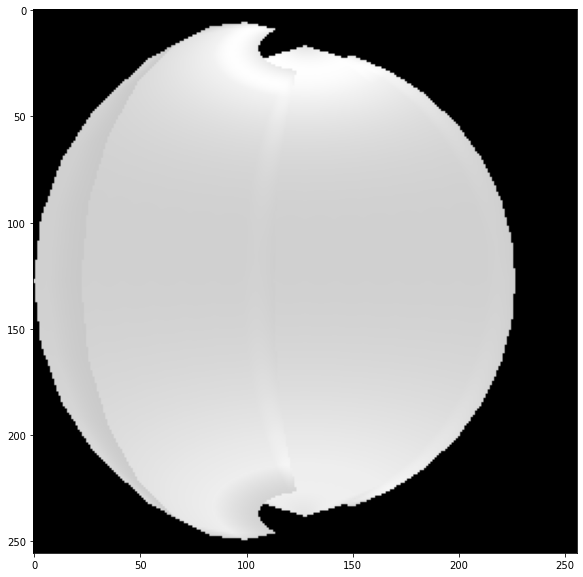

In [7]:
# Select the viewpoint using spherical angles  
distance = 4  # distance from camera to the object
elevation = 0   # angle of elevation in degrees
azimuth = 0  # No rotation so the camera is positioned on the +Z axis. 

# Get the position of the camera based on the spherical angles
R, T = look_at_view_transform(distance, elevation, azimuth, device=device)

# Render the teapot providing the values of R and T. 
image_ref = phong_renderer(meshes_world=calota_mesh, R=R, T=T)

image_ref = image_ref.cpu().numpy()
plt.figure(figsize=(10, 10))
plt.imshow(image_ref.squeeze())
plt.grid(False)

In [37]:
def render_image(mesh, distance=0, elevation=0, azimuth=0):
    # Get the position of the camera based on the spherical angles
    R, T = look_at_view_transform(distance, elevation, azimuth)
    # Render the teapot providing the values of R and T. 
    image_ref = phong_renderer(meshes_world=mesh, R=R, T=T)

    image_ref = image_ref.cpu().numpy()
    plt.figure(figsize=(10, 10))
    plt.imshow(image_ref.squeeze())
    plt.grid(False)

## Loading with Texture

In [8]:
# Util function for loading meshes
from pytorch3d.io import load_objs_as_meshes

In [10]:
tex_mesh = load_objs_as_meshes([mesh_path], device=device)
texture_image = tex_mesh.textures.maps_padded()

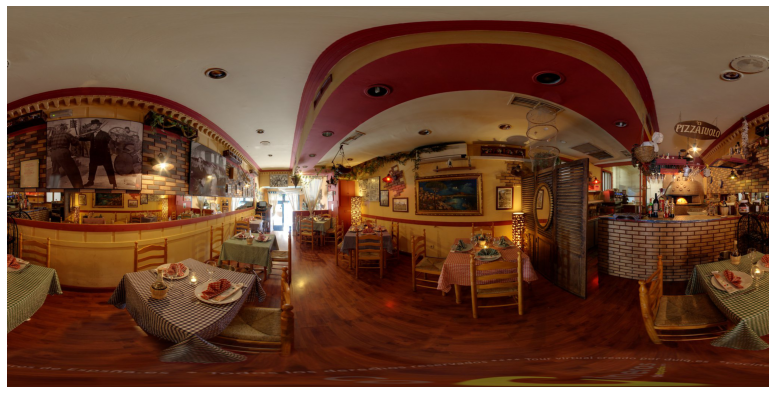

In [11]:
plt.figure(figsize=(14,7))
plt.imshow(texture_image.squeeze().cpu().numpy())
plt.grid("off");
plt.axis('off');

In [12]:
# Define the settings for rasterization and shading. Here we set the output image to be of size
# 512x512. As we are rendering images for visualization purposes only we will set faces_per_pixel=1
# and blur_radius=0.0. We also set bin_size and max_faces_per_bin to None which ensure that 
# the faster coarse-to-fine rasterization method is used. Refer to rasterize_meshes.py for 
# explanations of these parameters. Refer to docs/notes/renderer.md for an explanation of 
# the difference between naive and coarse-to-fine rasterization. 
raster_settings = RasterizationSettings(
    image_size=512, 
    blur_radius=0.0, 
    faces_per_pixel=1, 
    bin_size = None,  # this setting controls whether naive or coarse-to-fine rasterization is used
    max_faces_per_bin = None  # this setting is for coarse rasterization
)

# Place a point light in front of the object. As mentioned above, the front of the cow is facing the 
# -z direction. 
lights = PointLights(device=device, location=[[0.0, 0.0, 0.0]])

# Create a phong renderer by composing a rasterizer and a shader. The textured phong shader will 
# interpolate the texture uv coordinates for each vertex, sample from a texture image and 
# apply the Phong lighting model
renderer = MeshRenderer(
    rasterizer=MeshRasterizer(
        cameras=cameras, 
        raster_settings=raster_settings
    ),
    shader=TexturedSoftPhongShader(
        device=device, 
        cameras=cameras,
        lights=lights
    )
)

In [23]:
def render_texture(mesh, distance=0, elevation=0, azimuth=0, filename=None):
    # Get the position of the camera based on the spherical angles
    R, T = look_at_view_transform(distance, elevation, azimuth, device=device)

    # Render the mesh providing the values of R and T. 
    images = renderer(meshes_world=mesh, R=R, T=T)

    plt.figure(figsize=(10, 10))
    plt.imshow(images[0, ..., :3].cpu().numpy())
    plt.grid("off")
    plt.axis("off")
    if filename is not None:
        plt.savefig(filename)


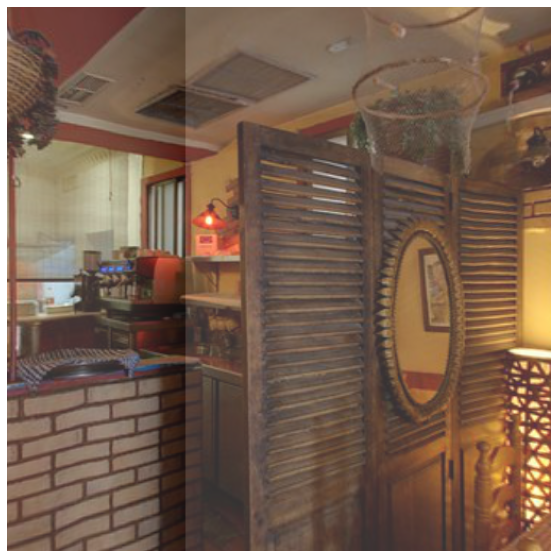

In [16]:
render_texture(tex_mesh, 0.0001, 0, 0)

saved image data/meshes/sphere/render/calota180_AZ0.jpg
saved image data/meshes/sphere/render/calota180_AZ5.jpg
saved image data/meshes/sphere/render/calota180_AZ10.jpg
saved image data/meshes/sphere/render/calota180_AZ15.jpg
saved image data/meshes/sphere/render/calota180_AZ20.jpg
saved image data/meshes/sphere/render/calota180_AZ25.jpg
saved image data/meshes/sphere/render/calota180_AZ30.jpg
saved image data/meshes/sphere/render/calota180_AZ35.jpg
saved image data/meshes/sphere/render/calota180_AZ40.jpg
saved image data/meshes/sphere/render/calota180_AZ45.jpg
saved image data/meshes/sphere/render/calota180_AZ50.jpg
saved image data/meshes/sphere/render/calota180_AZ55.jpg
saved image data/meshes/sphere/render/calota180_AZ60.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/render/calota180_AZ65.jpg
saved image data/meshes/sphere/render/calota180_AZ70.jpg
saved image data/meshes/sphere/render/calota180_AZ75.jpg
saved image data/meshes/sphere/render/calota180_AZ80.jpg
saved image data/meshes/sphere/render/calota180_AZ85.jpg
saved image data/meshes/sphere/render/calota180_AZ90.jpg
saved image data/meshes/sphere/render/calota180_AZ95.jpg


/Users/hallpaz/Workspace/impa/s3d/venv/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


saved image data/meshes/sphere/render/calota180_AZ100.jpg
saved image data/meshes/sphere/render/calota180_AZ105.jpg
saved image data/meshes/sphere/render/calota180_AZ110.jpg
saved image data/meshes/sphere/render/calota180_AZ115.jpg
saved image data/meshes/sphere/render/calota180_AZ120.jpg
saved image data/meshes/sphere/render/calota180_AZ125.jpg
saved image data/meshes/sphere/render/calota180_AZ130.jpg
saved image data/meshes/sphere/render/calota180_AZ135.jpg
saved image data/meshes/sphere/render/calota180_AZ140.jpg
saved image data/meshes/sphere/render/calota180_AZ145.jpg
saved image data/meshes/sphere/render/calota180_AZ150.jpg
saved image data/meshes/sphere/render/calota180_AZ155.jpg
saved image data/meshes/sphere/render/calota180_AZ160.jpg
saved image data/meshes/sphere/render/calota180_AZ165.jpg
saved image data/meshes/sphere/render/calota180_AZ170.jpg
saved image data/meshes/sphere/render/calota180_AZ175.jpg
saved image data/meshes/sphere/render/calota180_AZ180.jpg
saved image da

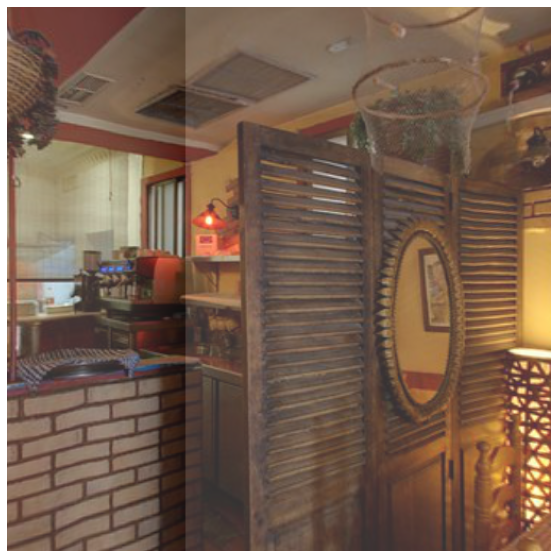

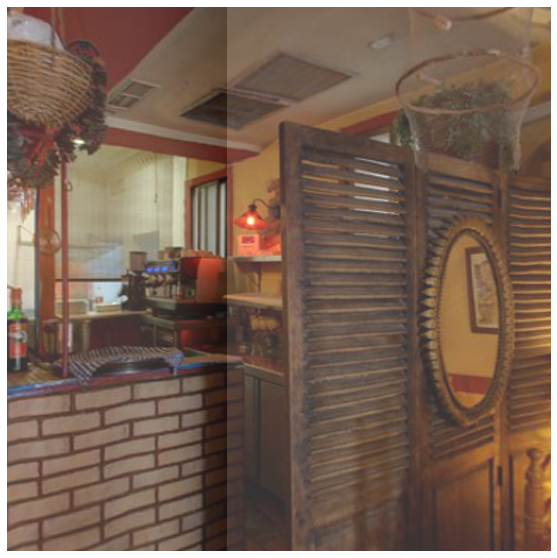

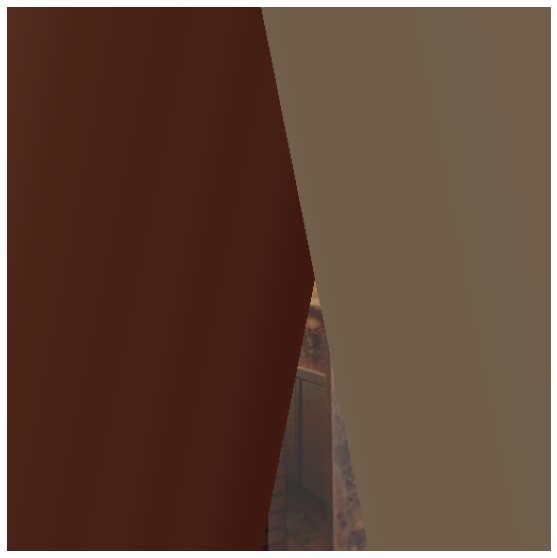

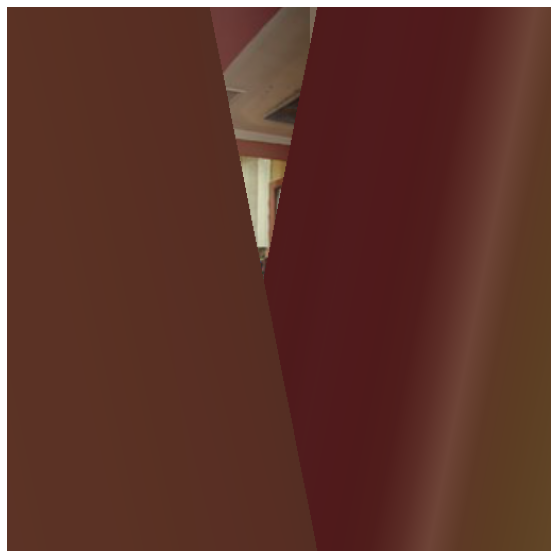

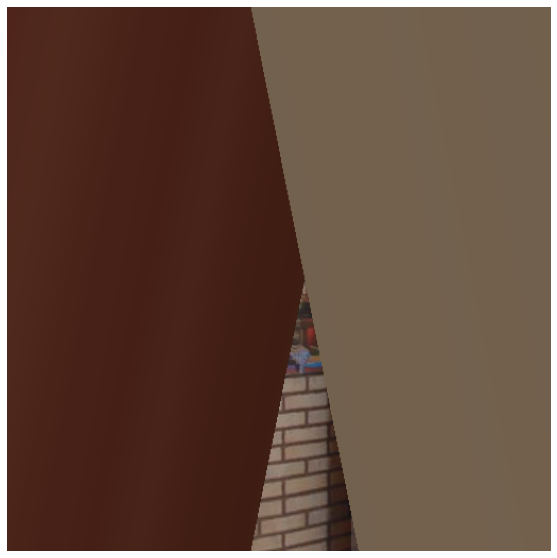

...

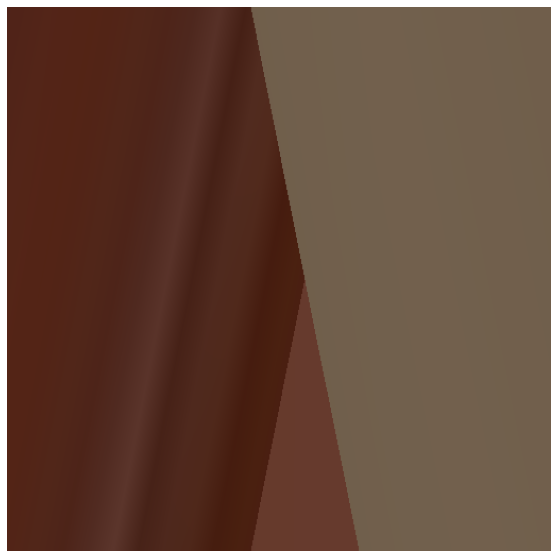

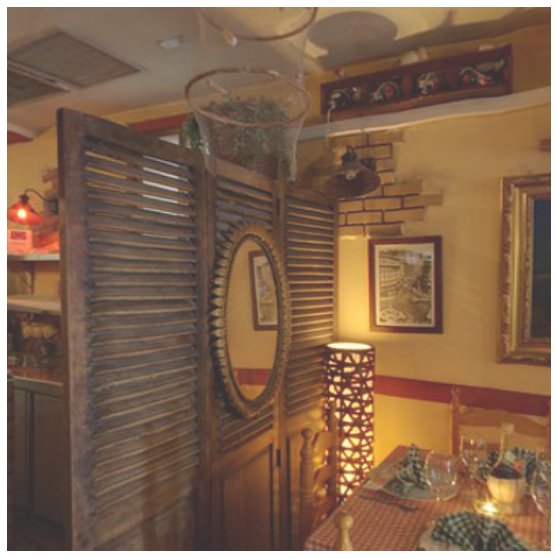

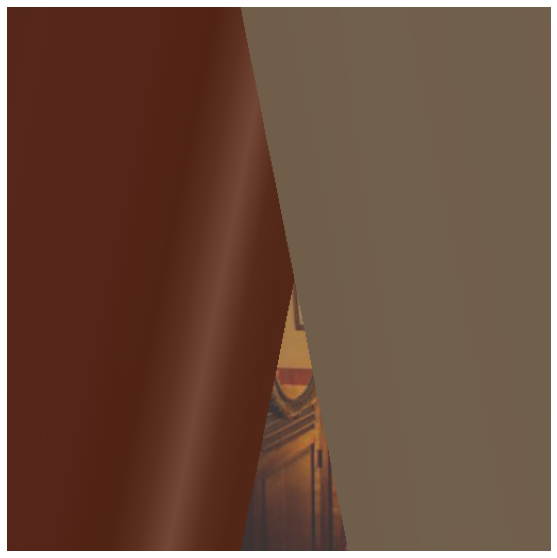

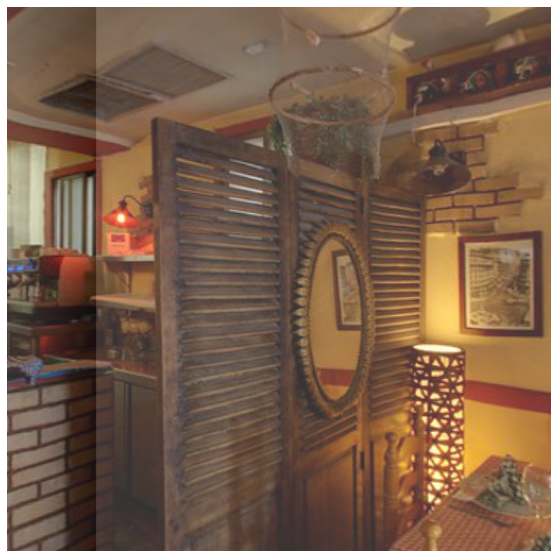

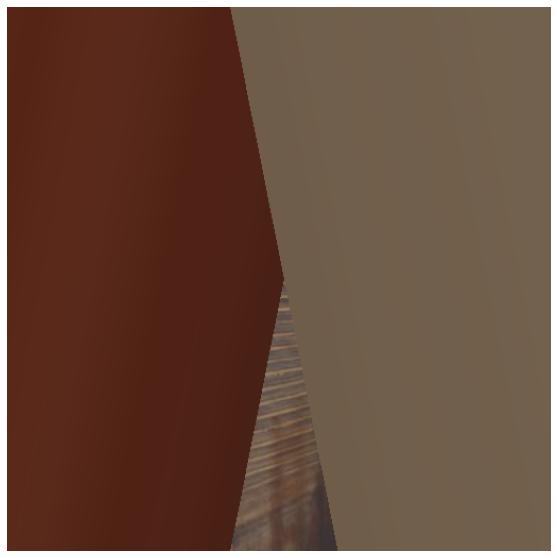

In [25]:
for i in range(360//5):
    dist = 0.0001
    azmth = i*5
    fname = os.path.join(DATA_DIR, 'render', 'calota180_AZ{}.jpg'.format(azmth))
    render_texture(tex_mesh, distance=dist, azimuth=azmth, filename=fname)
    print("saved image {}".format(fname))
    

In [28]:
def save_tour(mesh, prefix):
    for i in range(360//5):
        dist = 0.0001
        azmth = i*5
        fname = os.path.join(DATA_DIR, prefix, '{}_AZ{}.jpg'.format(prefix, azmth))
        render_texture(mesh, distance=dist, azimuth=azmth, filename=fname)
        print("saved image {}".format(fname))

In [33]:
calota135 = load_objs_as_meshes(
    [os.path.join(DATA_DIR, 'calota135.obj')], 
    device=device
)

saved image data/meshes/sphere/calota135/calota135_AZ0.jpg
saved image data/meshes/sphere/calota135/calota135_AZ5.jpg
saved image data/meshes/sphere/calota135/calota135_AZ10.jpg
saved image data/meshes/sphere/calota135/calota135_AZ15.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/calota135/calota135_AZ20.jpg
saved image data/meshes/sphere/calota135/calota135_AZ25.jpg
saved image data/meshes/sphere/calota135/calota135_AZ30.jpg
saved image data/meshes/sphere/calota135/calota135_AZ35.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/calota135/calota135_AZ40.jpg
saved image data/meshes/sphere/calota135/calota135_AZ45.jpg
saved image data/meshes/sphere/calota135/calota135_AZ50.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/calota135/calota135_AZ55.jpg
saved image data/meshes/sphere/calota135/calota135_AZ60.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/calota135/calota135_AZ65.jpg
saved image data/meshes/sphere/calota135/calota135_AZ70.jpg
saved image data/meshes/sphere/calota135/calota135_AZ75.jpg
saved image data/meshes/sphere/calota135/calota135_AZ80.jpg
saved image data/meshes/sphere/calota135/calota135_AZ85.jpg
saved image data/meshes/sphere/calota135/calota135_AZ90.jpg
saved image data/meshes/sphere/calota135/calota135_AZ95.jpg


/Users/hallpaz/Workspace/impa/s3d/venv/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


saved image data/meshes/sphere/calota135/calota135_AZ100.jpg
saved image data/meshes/sphere/calota135/calota135_AZ105.jpg
saved image data/meshes/sphere/calota135/calota135_AZ110.jpg
saved image data/meshes/sphere/calota135/calota135_AZ115.jpg
saved image data/meshes/sphere/calota135/calota135_AZ120.jpg
saved image data/meshes/sphere/calota135/calota135_AZ125.jpg
saved image data/meshes/sphere/calota135/calota135_AZ130.jpg
saved image data/meshes/sphere/calota135/calota135_AZ135.jpg
saved image data/meshes/sphere/calota135/calota135_AZ140.jpg
saved image data/meshes/sphere/calota135/calota135_AZ145.jpg
saved image data/meshes/sphere/calota135/calota135_AZ150.jpg
saved image data/meshes/sphere/calota135/calota135_AZ155.jpg
saved image data/meshes/sphere/calota135/calota135_AZ160.jpg
saved image data/meshes/sphere/calota135/calota135_AZ165.jpg
saved image data/meshes/sphere/calota135/calota135_AZ170.jpg
saved image data/meshes/sphere/calota135/calota135_AZ175.jpg
saved image data/meshes/

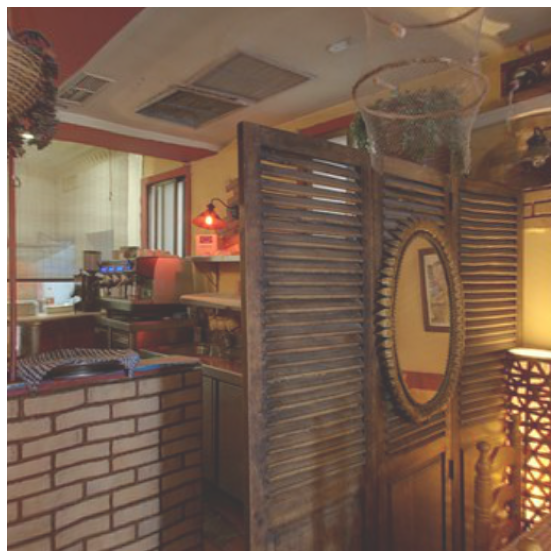

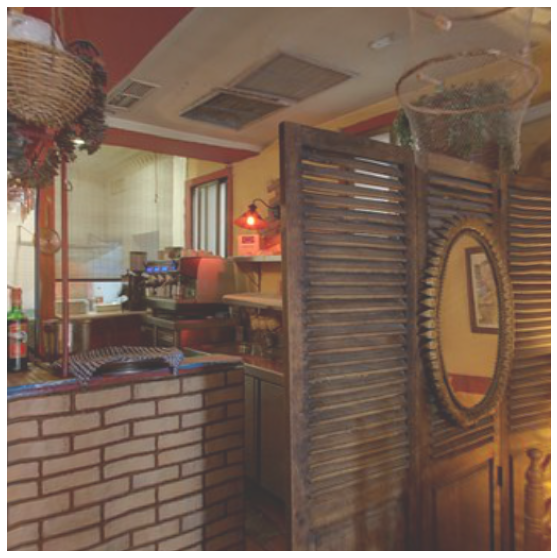

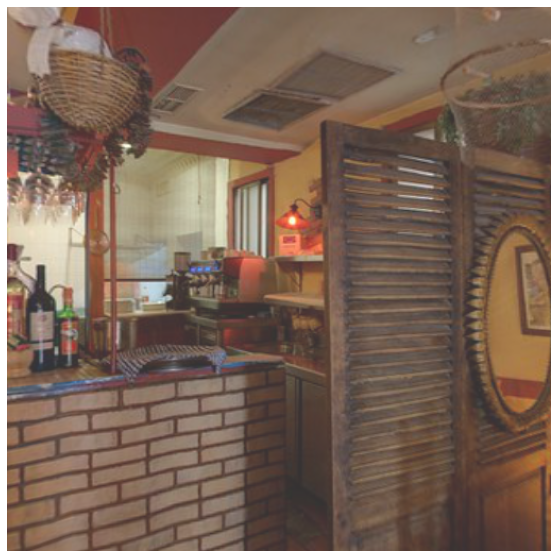

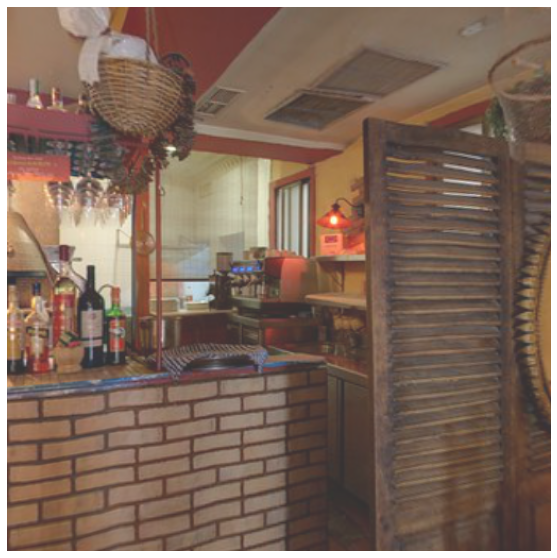

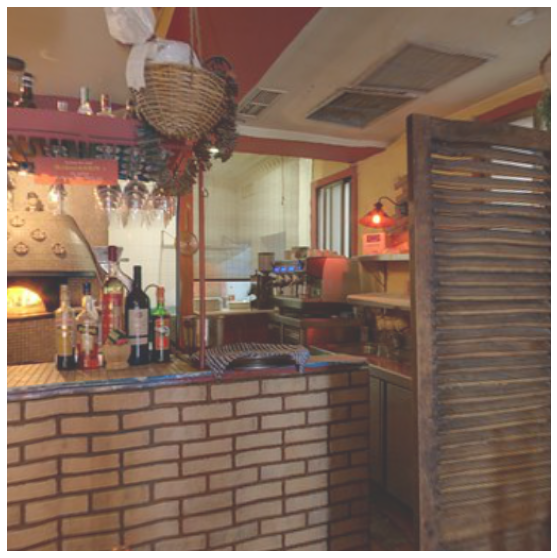

...

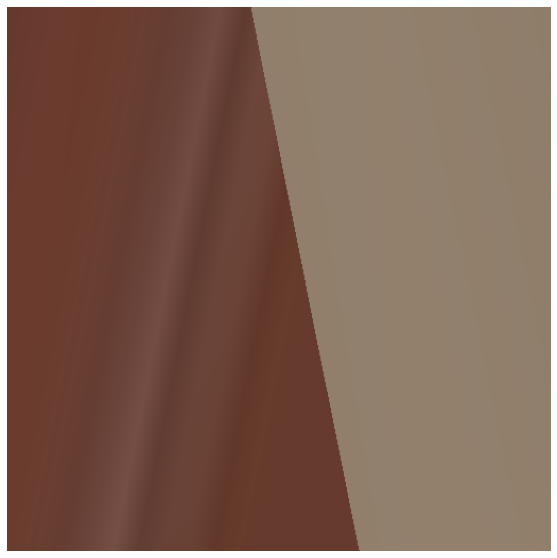

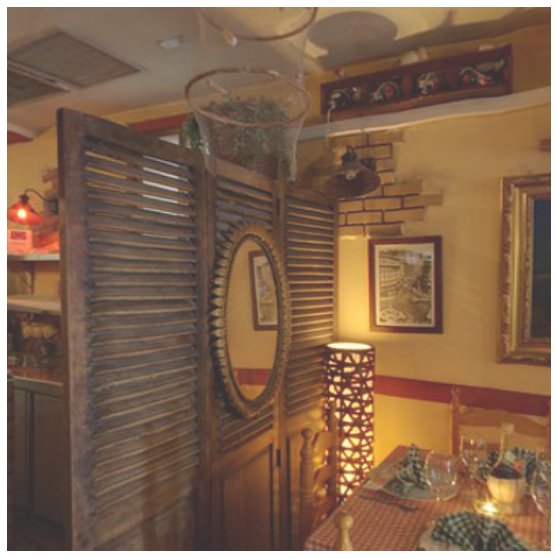

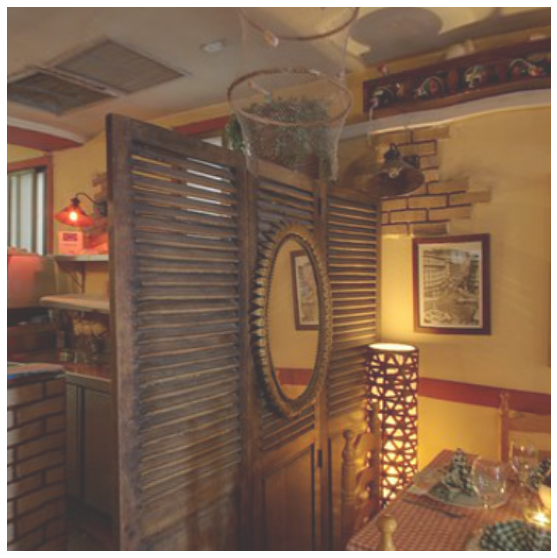

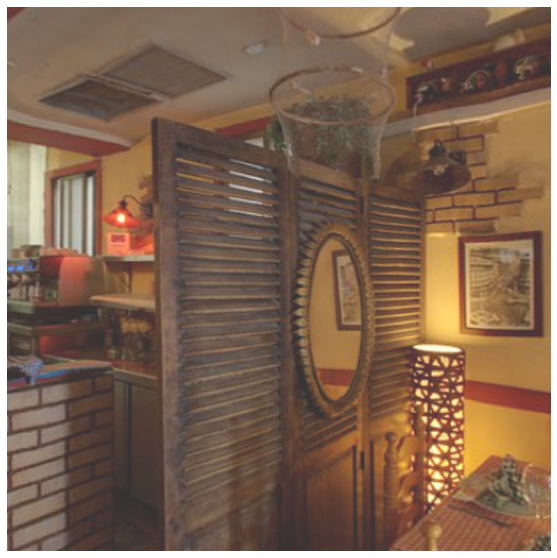

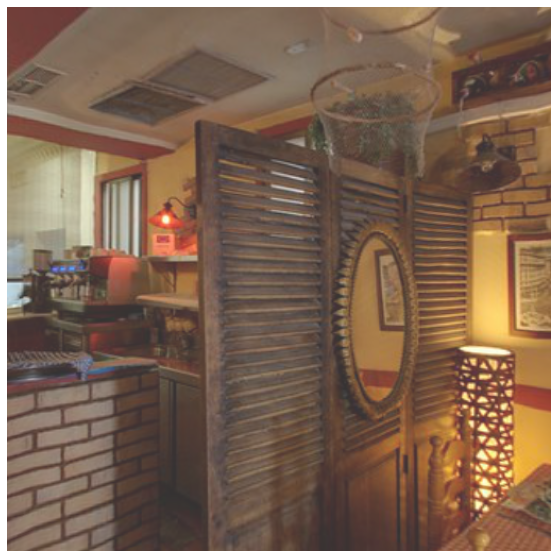

In [34]:
save_tour(calota135, 'calota135')

saved image data/meshes/sphere/calota_small/calota_small_AZ0.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ5.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ10.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ15.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/calota_small/calota_small_AZ20.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ25.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ30.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ35.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/calota_small/calota_small_AZ40.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ45.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ50.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/calota_small/calota_small_AZ55.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ60.jpg


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


saved image data/meshes/sphere/calota_small/calota_small_AZ65.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ70.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ75.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ80.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ85.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ90.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ95.jpg


/Users/hallpaz/Workspace/impa/s3d/venv/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


saved image data/meshes/sphere/calota_small/calota_small_AZ100.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ105.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ110.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ115.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ120.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ125.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ130.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ135.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ140.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ145.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ150.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ155.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ160.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ165.jpg
saved image data/meshes/sphere/calota_small/calota_small_AZ170

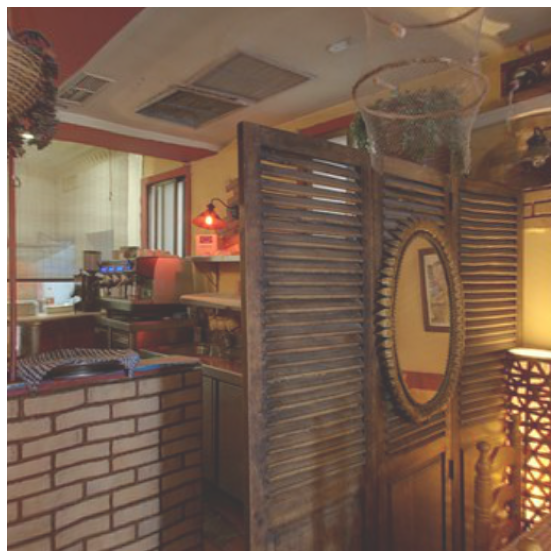

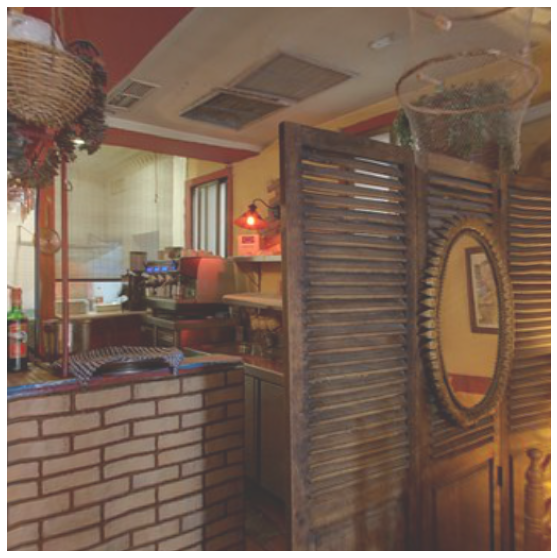

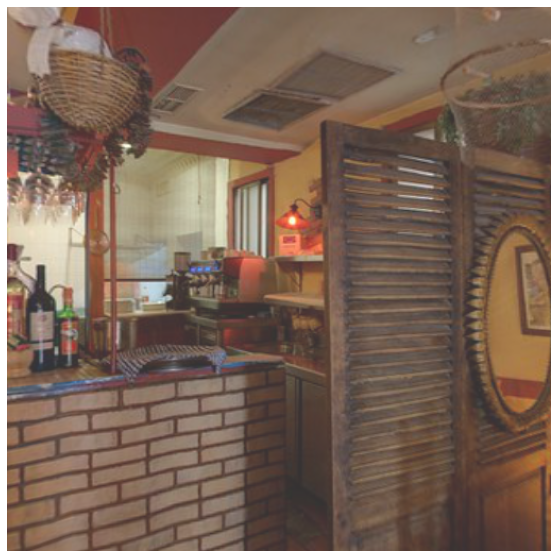

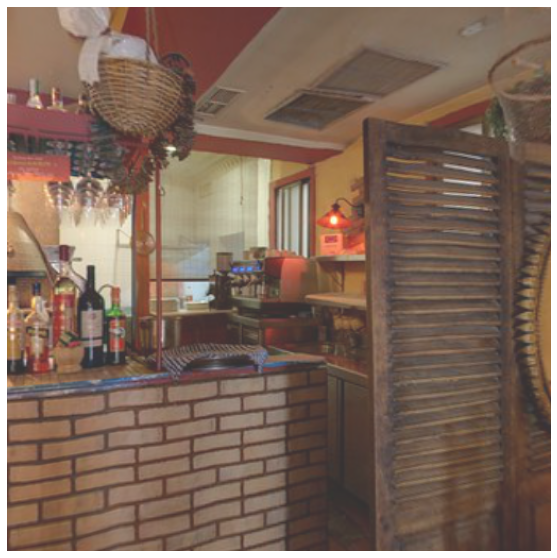

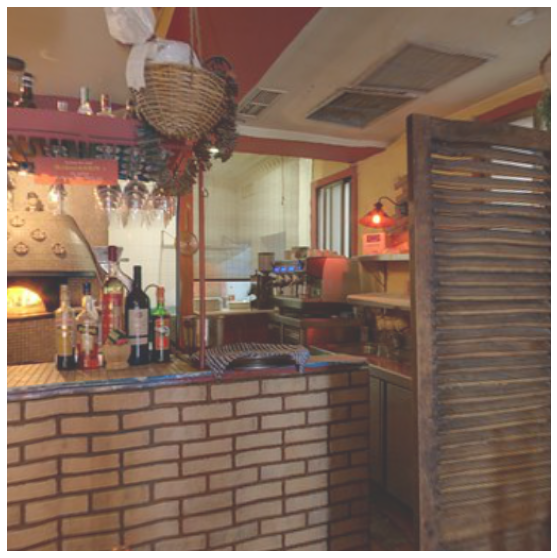

...

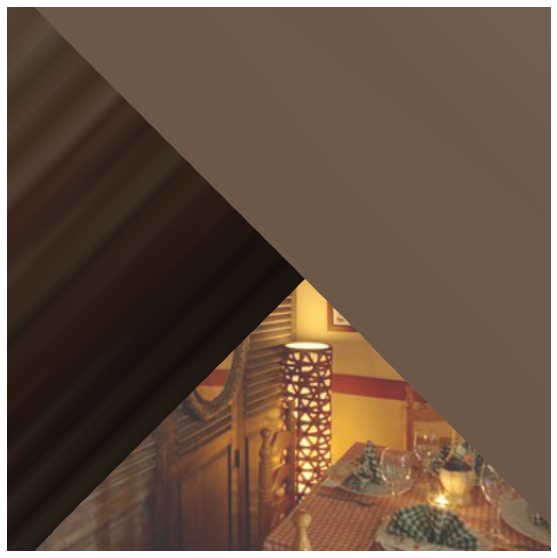

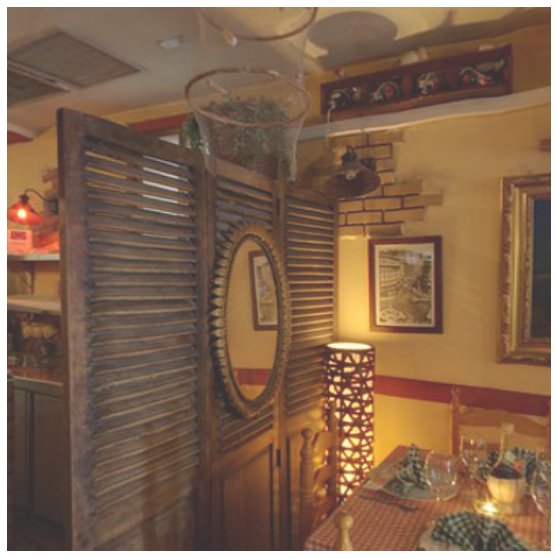

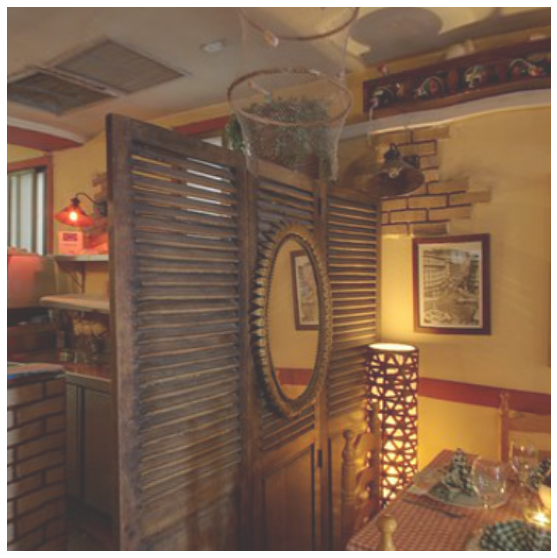

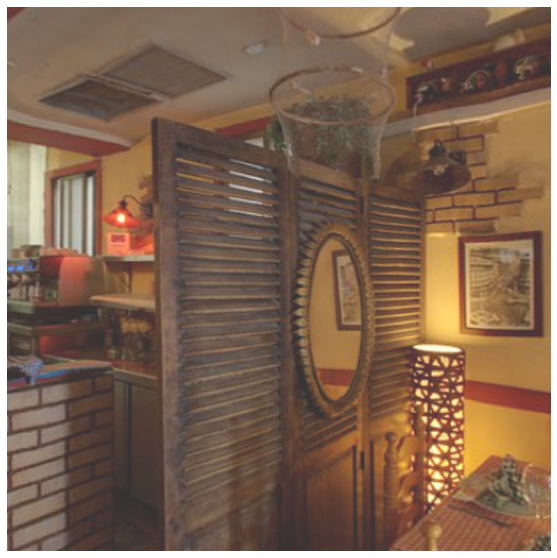

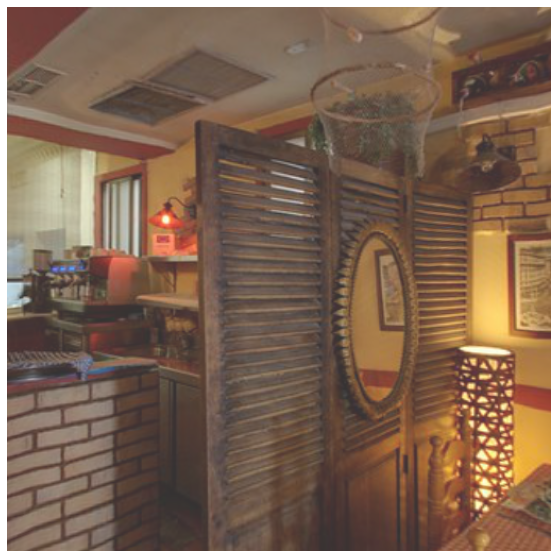

In [35]:
calota_small = load_objs_as_meshes(
    [os.path.join(DATA_DIR, 'calota_small.obj')], 
    device=device
)
save_tour(calota_small, 'calota_small')